In [57]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Business Case Analysis
 - This is to understand the factors that affect the flight fares
 - The data gives various factors such as, the brand of airline, the date of journey, Source and Destination, the journey duration, no. of stops, departure and arrival times and the price of that particular journey.
 - We have to see which of these really affect the flight price, and which of these do not have effect on the flight prices.
 - Based on that, we need to design a ML model that will give us the flight price based on the factors affecting it. 
 - Hence price is the target variable, while the others are features.
 - It is to be noted that, the time gap between date of booking and date of journey is not present in data, which is also an important variable in deciding the price of travel

## Basic Data Checks
- We observe the data, understand the data type, the distrubution of values of numerical columns, the statistics of all columns

In [58]:
#Load data from excel
data_flight = pd.read_excel('Flight_Fare.xlsx')

In [59]:
#Set option to display all rows
pd.set_option('display.max_rows',None)
data_flight

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302
5,SpiceJet,24/06/2019,Kolkata,Banglore,CCU → BLR,09:00,11:25,2h 25m,non-stop,No info,3873
6,Jet Airways,12/03/2019,Banglore,New Delhi,BLR → BOM → DEL,18:55,10:25 13 Mar,15h 30m,1 stop,In-flight meal not included,11087
7,Jet Airways,01/03/2019,Banglore,New Delhi,BLR → BOM → DEL,08:00,05:05 02 Mar,21h 5m,1 stop,No info,22270
8,Jet Airways,12/03/2019,Banglore,New Delhi,BLR → BOM → DEL,08:55,10:25 13 Mar,25h 30m,1 stop,In-flight meal not included,11087
9,Multiple carriers,27/05/2019,Delhi,Cochin,DEL → BOM → COK,11:25,19:15,7h 50m,1 stop,No info,8625


In [60]:
#Basic data checks
data_flight.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10682 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10682 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


In [61]:
data_flight.describe() #Statistical info of the numerical columns

,Price
count,10683.000000
mean,9087.064121
std,4611.359167
min,1759.000000
25%,5277.000000
50%,8372.000000
75%,12373.000000
max,79512.000000


In [62]:
#Check for object columns
data_flight.describe(include = 'O')

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info
count,10683,10683,10683,10683,10682,10683,10683,10683,10682,10683
unique,12,44,5,6,128,222,1343,368,5,10
top,Jet Airways,18/05/2019,Delhi,Cochin,DEL → BOM → COK,18:55,19:00,2h 50m,1 stop,No info
freq,3849,504,4537,4537,2376,233,423,550,5625,8345


In [63]:
data_flight.columns

Index(['Airline', 'Date_of_Journey', 'Source', 'Destination', 'Route',
       'Dep_Time', 'Arrival_Time', 'Duration', 'Total_Stops',
       'Additional_Info', 'Price'],
      dtype='object')

In [64]:
#Unique values and value counts for all columns
for i in data_flight.columns:
    print(f'\n\n Unique values in {i} columns is :', data_flight[i].unique())
    print(f'\n The Value counts in {i} column is :\n', data_flight[i].value_counts())



 Unique values in Airline columns is : ['IndiGo' 'Air India' 'Jet Airways' 'SpiceJet' 'Multiple carriers' 'GoAir'
 'Vistara' 'Air Asia' 'Vistara Premium economy' 'Jet Airways Business'
 'Multiple carriers Premium economy' 'Trujet']

 The Value counts in Airline column is :
 Jet Airways                          3849
IndiGo                               2053
Air India                            1752
Multiple carriers                    1196
SpiceJet                              818
Vistara                               479
Air Asia                              319
GoAir                                 194
Multiple carriers Premium economy      13
Jet Airways Business                    6
Vistara Premium economy                 3
Trujet                                  1
Name: Airline, dtype: int64


 Unique values in Date_of_Journey columns is : ['24/03/2019' '1/05/2019' '9/06/2019' '12/05/2019' '01/03/2019'
 '24/06/2019' '12/03/2019' '27/05/2019' '1/06/2019' '18/04/2019'
 '9/05/2019' 

## Data Cleaning
 - Based on the list of unique values, it is figured out, that of the unique values in Total_Stops column, there is a 'nan' data, that is a missing/wrong value
 - In the column Additional_Info, there are two values 'No Info'(3 rows), 'No info'(8345 rows). Both were shown to be unique, but in reality, they both are the same. So we need to merge them
 - Before we go to EDA, it is necessary to fix these, to understand the real impact of the features on data. 

In [65]:
#Null values
data_flight.isnull().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              1
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        1
Additional_Info    0
Price              0
dtype: int64

In [66]:
data_flight.loc[data_flight.Route.isnull()] #This row has null value for route and total stops. 

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
9039,Air India,6/05/2019,Delhi,Cochin,NaN,09:45,09:25 07 May,23h 40m,NaN,No info,7480


In [67]:
data_flight.Total_Stops.unique()

array(['non-stop', '2 stops', '1 stop', '3 stops', nan, '4 stops'],
      dtype=object)

In [68]:
data_flight.loc[data_flight.Total_Stops.isnull()]

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
9039,Air India,6/05/2019,Delhi,Cochin,NaN,09:45,09:25 07 May,23h 40m,NaN,No info,7480


In [69]:
data_flight.loc[data_flight.Total_Stops.isnull(),'Total_Stops']
#There is one row with null value for Total_Stops. 
#We will fill that value with the mode value of 'Total_Stops', considering only those rows whose duration 
#is 20 hours or more, but when the string data encoding is done. 
#Since its only one single row, it will not affect our EDA

9039    NaN
Name: Total_Stops, dtype: object

In [70]:
#We will replace 'No Info' with 'No info'
data_flight.loc[data_flight.Additional_Info == 'No Info','Additional_Info'] = 'No info'

In [71]:
data_flight.Additional_Info.unique()

array(['No info', 'In-flight meal not included',
       'No check-in baggage included', '1 Short layover',
       '1 Long layover', 'Change airports', 'Business class',
       'Red-eye flight', '2 Long layover'], dtype=object)

## EDA
## We will observe how different parameters vary (univariate analysis) and how their variance is interdependent and is dependent on target variable (bivariate analysis)

### Univariate Analysis

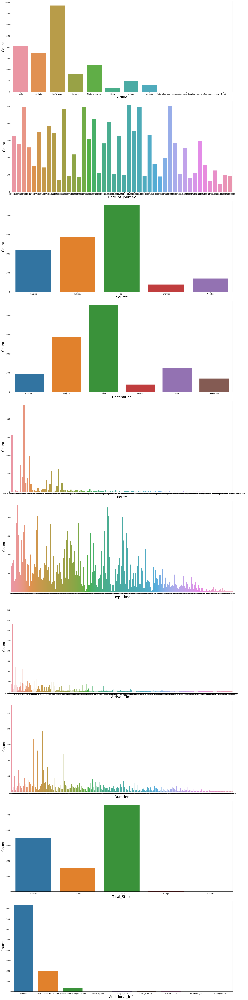

In [72]:
#Observe the counts of each unique value in data
data1_flight = data_flight.drop('Price',axis=1)
plt.figure(figsize = (20,80))
plt_number = 1
for i in data1_flight.columns:
    plt.subplot(10,1,plt_number)
    sns.countplot(x = data1_flight[i])
    plt.xlabel(i,fontsize = 20)
    plt.ylabel('Count',fontsize = 20)
    plt_number += 1
plt.tight_layout()

<AxesSubplot:xlabel='Price', ylabel='Count'>

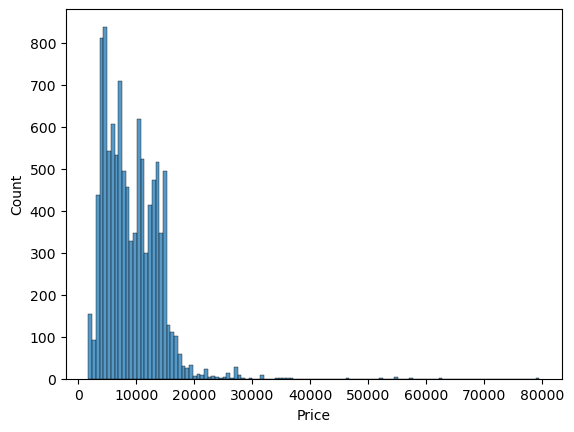

In [73]:
sns.histplot(x = data_flight.Price)

<AxesSubplot:xlabel='Price'>

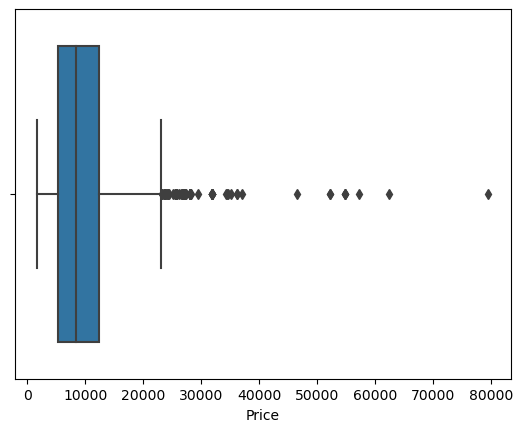

In [74]:
sns.boxplot(x = data_flight.Price)

### Insights from univariate analysis:
- Most flights have been of Jet Airways followed by Indigo and Air India. These three comprise to 80% of total flights.
- The counts of Date of journey show extreme variability, leaving a lot of room for further splitting and exploration
- The data shows that most flights that were under study originate from delhi (around 45%). It is followed by kolkata and bangalore, and both together contribute as origin to 50% of flights. 
- About 95% of flights have their origin as either bangalore, kolkata and delhi. 
- Very less number of flights originated at Chennai and Mumbai. 
- About 45% of flights have their destination as Cochin (followed by bangalore - about 25%).
- Kolkata seems to be having least count of flights as destination as per the observations.
- Delhi to Cochin via Bombay seems to be the most famous route, with about 25% of flights through that route. The next highest sought route is Bangalore to Delhi.
- Higher number of departures can be seen between 7am - 10am or 5pm - 7pm.
- More flights seem to have an arrival time of around 7pm-9pm.
- Most flights seem to have a flight duration between 1.5 hours to 3 hours.
- Most flights seem to be of 1-stop (about 50%). Non stop flights amount to 30% of the data. Flights with 2 or more stops is very less. 
- Though not much flight data had additional info, there was about 20% of flights with no meals included in flight. Some even had check in baggage included.
- The fare of most flights vary from 5k-15k. Very less number of flights are priced at greater than 30K

### Bivariate Analysis: In this the variance of price with respect to different features is studied. 
 - The features 'Date of Journey', can be analysed only after it's broken down into date, week, month and year, since they are the real features behind the price decision
 - Even, the analysis of price with 'Departure Time', 'Arrival Time', 'Duration', can be understood better only if they are converted to meaningful number. 
 - 'Arrival Time' column needs some cleaning too.

<AxesSubplot:xlabel='Price', ylabel='Airline'>

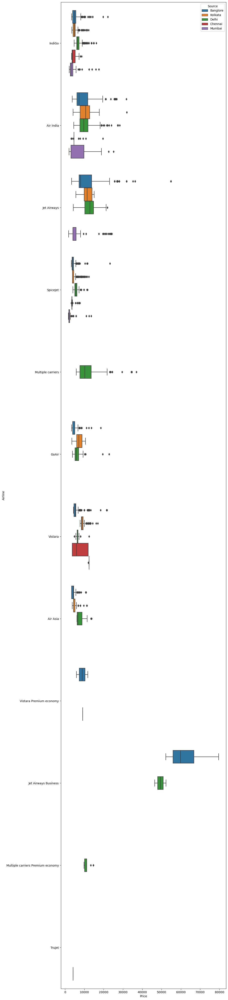

In [75]:
#Price ranges of different airlines with all origin cities
plt.figure(figsize=(10,60))
sns.boxplot(x = data_flight.Price, y = data_flight.Airline, hue = data_flight.Source)

<AxesSubplot:xlabel='Price', ylabel='Airline'>

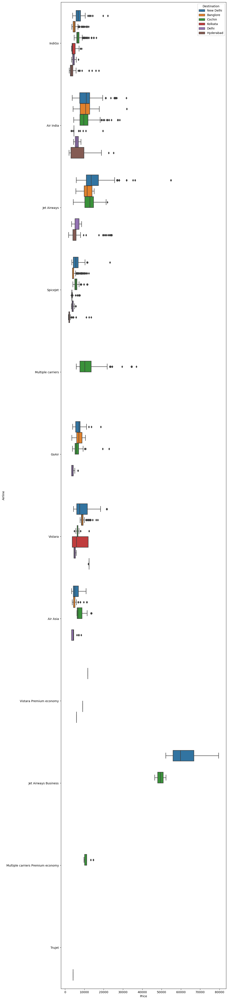

In [76]:
#Price ranges of different airlines with all destination cities
plt.figure(figsize=(10,60))
sns.boxplot(x = data_flight.Price, y = data_flight.Airline, hue = data_flight.Destination)

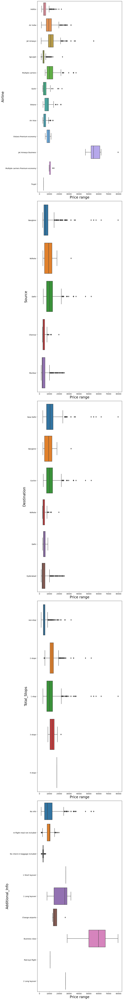

In [77]:
#Range of prices for different airlines, sources, destinations, total stops and extra info
plt.figure(figsize = (10,80))
plt_number = 1
for i in ['Airline','Source','Destination','Total_Stops','Additional_Info']:
    plt.subplot(5,1,plt_number)
    sns.boxplot(data=data_flight, x="Price", y=i)
    plt.ylabel(i,fontsize = 20)
    plt.xlabel('Price range',fontsize = 20)
    plt_number += 1
plt.tight_layout()

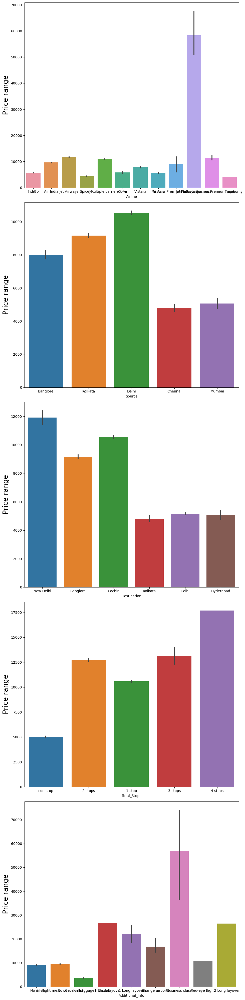

In [78]:
#Price range for different airlines, source, destination, total stops and additional info
plt.figure(figsize = (10,40))
plt_number = 1
for i in ['Airline','Source','Destination','Total_Stops','Additional_Info']:
    plt.subplot(5,1,plt_number)
    sns.barplot(data=data_flight, y="Price", x=i)
    plt.xlabel(i,fontsize = 10)
    plt.ylabel('Price range',fontsize = 20)
    plt_number += 1
plt.tight_layout()

Text(0.5, 0, 'Price range')

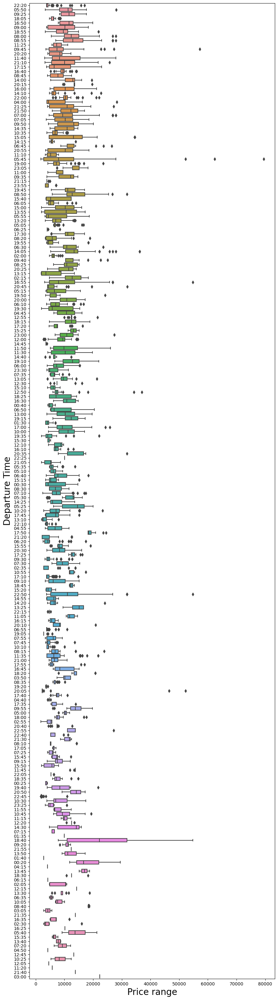

In [79]:
#Box plots to understand data spread and outliers
plt.figure(figsize = (10,40))    
sns.boxplot(data=data_flight, x="Price", y='Dep_Time')
plt.ylabel('Departure Time',fontsize = 20)
plt.xlabel('Price range',fontsize = 20)

Text(0.5, 0, 'Price range')

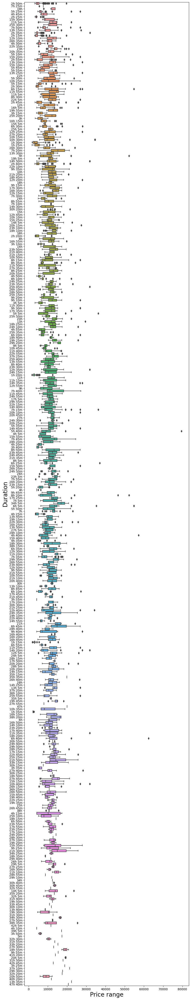

In [80]:
plt.figure(figsize = (10,60)) 
sns.boxplot(data=data_flight, x="Price", y='Duration')
plt.ylabel('Duration',fontsize = 20)
plt.xlabel('Price range',fontsize = 20)


Text(0.5, 0, 'Price range')

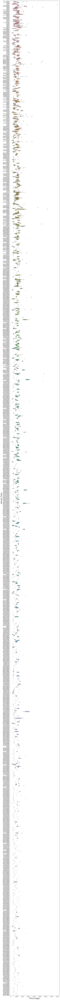

In [81]:
plt.figure(figsize = (10,200)) 
sns.boxplot(data=data_flight, x="Price", y='Arrival_Time')
plt.ylabel('Arrival_Time',fontsize = 20)
plt.xlabel('Price range',fontsize = 20)
    

In [82]:
#Sorting the data based on flight price to understand the features contributing to price
data_flight.loc[data_flight.Price<5000].sort_values(by = 'Price') 

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
10513,SpiceJet,27/03/2019,Mumbai,Hyderabad,BOM → HYD,05:45,07:05,1h 20m,non-stop,No info,1759
4274,SpiceJet,27/03/2019,Mumbai,Hyderabad,BOM → HYD,22:45,00:10 28 Mar,1h 25m,non-stop,No info,1759
4839,SpiceJet,3/04/2019,Mumbai,Hyderabad,BOM → HYD,22:45,00:15 02 Apr,1h 30m,non-stop,No info,1759
4066,SpiceJet,21/03/2019,Mumbai,Hyderabad,BOM → HYD,22:45,00:10 22 Mar,1h 25m,non-stop,No info,1759
1513,Jet Airways,27/03/2019,Mumbai,Hyderabad,BOM → HYD,02:55,04:25,1h 30m,non-stop,In-flight meal not included,1840
4595,SpiceJet,3/05/2019,Mumbai,Hyderabad,BOM → HYD,05:45,07:15,1h 30m,non-stop,No check-in baggage included,1965
9142,SpiceJet,24/05/2019,Mumbai,Hyderabad,BOM → HYD,22:45,00:15 25 May,1h 30m,non-stop,No check-in baggage included,1965
1652,SpiceJet,9/05/2019,Mumbai,Hyderabad,BOM → HYD,05:45,07:15,1h 30m,non-stop,No check-in baggage included,1965
1580,SpiceJet,24/06/2019,Mumbai,Hyderabad,BOM → HYD,22:45,00:15 25 Jun,1h 30m,non-stop,No check-in baggage included,1965
1472,SpiceJet,21/05/2019,Mumbai,Hyderabad,BOM → HYD,13:15,14:45,1h 30m,non-stop,No check-in baggage included,1965


## Observations from Bivariate Analysis
- Indigo, GoAir, AirAsia, SpiceJet, TruJet seem to be the economy range of flights, as the range of their prices is low. Air India, Jet Airways,Multiple Carriers, Vistara, Vistara Premium Economy, Multiple Carriers Premium Economy seem to be of slightly higher range (Mid range pricing). 
- Jet Airways Business seems to be highly priced. So the airline type does affect the price of flight.
- Flights originating from 'Chennai' and 'Mumbai' are seemingly less priced, while the flights departing from the remaining origins are all priced in similar range barring the business class flights.
- Flights whose destination is Kolkata, Delhi or Hyderabad seem to be of lesser pricing than other destinations, barring the business class flight.
- Most of the less-priced flights are non stop, while, 1-stop flights are seemingly operated in moderately higher price segement. It gets expensive when flights have more than 2 stops.
- Flights with layover seem to be expensive, while flights with 'no checkin baggage included' are cheaper.
- Flights with departures at Early Morning, Noon or Late nights are relatively less priced than other timings
- Similarly flights reaching the destinations in mid night or early hours (22.00 - 6.00) are cheaper
- The duration of the flight and the flight price seem to be directly proportional, with shorter duration flights being cheaper.
- Business class flights in the data seem to be flying from either bangalore or delhi only and their destination is either delhi or cochin. 

## An observation of collective data for flights priced < 5000 INR
 - Least priced flights are between Mumbai-Hyderabad. In that, the flights with departures late in the night or early in the morning are priced lesser. The average flight duration in all cases is around 90 minutes. Flights between same source-destination but in office timings are relatively higher priced.
 - The next least priced flights are between Bangalore-Delhi and then Chennai-Kolkata, Kolkata-Delhi. The average flight duration is 150-170 minutes.
 - Most of these least priced and next least priced ones have 'no checkin baggage included' and 'no inflight meals included'.
 - Flights in reasonable office timings are always relatively highly priced than the ones which are not.

In [83]:
#Sorting the data based on flight price to understand the features contributing to price
data_flight.loc[(data_flight.Price>5000)&(data_flight.Price<15000)].sort_values(by = 'Price') 

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
3659,Air India,9/04/2019,Kolkata,Banglore,CCU → MAA → BLR,14:35,14:35 10 Apr,24h,1 stop,No info,5006
6440,Air India,1/04/2019,Kolkata,Banglore,CCU → MAA → BLR,14:35,15:20 02 Apr,24h 45m,1 stop,No info,5006
443,Air India,15/03/2019,Banglore,New Delhi,BLR → HYD → DEL,08:15,12:15,4h,1 stop,No info,5013
202,IndiGo,24/04/2019,Delhi,Cochin,DEL → COK,05:35,08:50,3h 15m,non-stop,No info,5013
6523,IndiGo,3/04/2019,Delhi,Cochin,DEL → COK,21:05,00:20 04 Apr,3h 15m,non-stop,No info,5021
8481,IndiGo,27/04/2019,Delhi,Cochin,DEL → COK,14:20,17:35,3h 15m,non-stop,No info,5021
5960,IndiGo,18/03/2019,Delhi,Cochin,DEL → COK,21:05,00:20 19 Mar,3h 15m,non-stop,No info,5021
926,Air India,27/03/2019,Delhi,Cochin,DEL → BLR → COK,20:30,23:00 28 Mar,26h 30m,1 stop,No info,5022
6747,Air India,3/04/2019,Delhi,Cochin,DEL → BLR → COK,20:30,23:00 04 Apr,26h 30m,1 stop,No info,5022
7933,Air India,6/04/2019,Delhi,Cochin,DEL → BLR → COK,06:10,23:00,16h 50m,1 stop,No info,5022


## Flights priced between 5000 - 15000
 - Most flights in this price segment are between similar destinations, but with one stop and trave duration>3hours. 
 - An important observation is that, the flights in this price segment have their average departures and arrivals around 8am-11am and 5pm-8pm. 
 - So its expensive when we choose to travel in those timings

In [84]:
#Sorting the data based on flight price to understand the features contributing to price
data_flight.loc[(data_flight.Price>15000)&(data_flight.Price<25000)].sort_values(by = 'Price') 

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
1245,Jet Airways,06/03/2019,Banglore,New Delhi,BLR → BOM → DEL,14:05,11:25 07 Mar,21h 20m,1 stop,No info,15025
8170,Jet Airways,06/03/2019,Banglore,New Delhi,BLR → BOM → DEL,08:55,09:00 07 Mar,24h 5m,1 stop,No info,15025
9062,Jet Airways,9/03/2019,Delhi,Cochin,DEL → BOM → COK,02:15,04:25 10 Mar,26h 10m,1 stop,No info,15029
4842,Jet Airways,9/03/2019,Delhi,Cochin,DEL → BOM → COK,00:20,04:25 10 Mar,28h 5m,1 stop,No info,15029
2794,Jet Airways,9/03/2019,Delhi,Cochin,DEL → BOM → COK,21:50,04:25 10 Mar,6h 35m,1 stop,No info,15029
7117,Multiple carriers,24/06/2019,Delhi,Cochin,DEL → BOM → COK,07:05,19:15,12h 10m,1 stop,No info,15058
10071,Multiple carriers,12/06/2019,Delhi,Cochin,DEL → BOM → COK,08:00,19:15,11h 15m,1 stop,No info,15058
8923,Multiple carriers,3/06/2019,Delhi,Cochin,DEL → BOM → COK,08:00,19:15,11h 15m,1 stop,No info,15058
5234,Multiple carriers,21/05/2019,Delhi,Cochin,DEL → BOM → COK,08:00,19:15,11h 15m,1 stop,No info,15058
5451,Multiple carriers,3/06/2019,Delhi,Cochin,DEL → BOM → COK,07:05,19:15,12h 10m,1 stop,No info,15058


## Flights priced between 15000-25000
 - Most flights in this price segment are with 1-2 stops, with an average travel duration of 6 hours to 26 hours. 
 - There are no non stop flights in this price segment
 - An important observation is that, the flights in this price segment have their average departures and arrivals around 8am-11am and 5pm-8pm. 
 - Most fligths in this price segment are between Delhi-Cochin with 1-2 stops in between.

In [85]:
#Sorting the data based on flight price to understand the features contributing to price
data_flight.loc[data_flight.Price>25000].sort_values(by = 'Price') 

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
597,Air India,6/03/2019,Mumbai,Hyderabad,BOM → JDH → DEL → HYD,09:40,15:15 07 Mar,29h 35m,2 stops,No info,25139
5701,Air India,01/03/2019,Banglore,New Delhi,BLR → BOM → BHO → DEL,08:50,23:25 02 Mar,38h 35m,2 stops,No info,25430
2055,Air India,01/03/2019,Banglore,New Delhi,BLR → BOM → BHO → DEL,08:50,09:25 02 Mar,24h 35m,2 stops,No info,25430
8940,Air India,01/03/2019,Banglore,New Delhi,BLR → DEL,21:10,23:55,2h 45m,non-stop,No info,25703
5856,Jet Airways,01/03/2019,Banglore,New Delhi,BLR → BOM → DEL,11:40,10:25 02 Mar,22h 45m,1 stop,No info,25735
6314,Jet Airways,01/03/2019,Banglore,New Delhi,BLR → BOM → DEL,11:40,11:25 02 Mar,23h 45m,1 stop,No info,25735
6407,Jet Airways,01/03/2019,Banglore,New Delhi,BLR → BOM → DEL,22:50,21:20 02 Mar,22h 30m,1 stop,No info,25735
8536,Jet Airways,01/03/2019,Banglore,New Delhi,BLR → BOM → DEL,14:05,09:30 02 Mar,19h 25m,1 stop,No info,25735
936,Jet Airways,01/03/2019,Banglore,New Delhi,BLR → BOM → DEL,22:50,19:10 02 Mar,20h 20m,1 stop,No info,25735
9239,Jet Airways,01/03/2019,Banglore,New Delhi,BLR → BOM → DEL,22:50,23:00 02 Mar,24h 10m,1 stop,No info,25735


## Flights priced >25000
- Most flights in this price segment are with 1-2 stops, with an average travel duration of 6 hours to 22 hours.
- There are no non stop flights in this price segment
- An important observation is that, the flights in this price segment have their average departures or arrivals around 8am-11am and 5pm-8pm.
- Most fligths in this price segment are between Bangalore-New Delhi with layovers.
- The most expensive ones are of Business class, between the same source-Destination

# Data Pre-Processing:
 - Categorical columns (Airline, Source, Destination, Additional Info,No. of stos) to be converted into Numerical Columns by label Encoding
 - Date-Time columns (Date of Journey) are to be converted into date, day of the week, month and year.
 - Departure Time and Duration column needs to be broken down to hours and minutes
 - **Route column shall be dropped** since we know the source, destination and no. of stops
 - **Arrival Time column shall be dropped** since we know the departure time and travel duration. Also, relatively, departure time is more controlled/fixed and is of interest to the customer. 
 - Row #9039 has null value and must be filled in, for the no. of stops

## An observation of outliers:
 - Though the data looks like it has outliers, (the price range), it is quite possible to have variability in flight prices based on time and week of the day, festival calendars, demand and date of booking. Also, considering that the most outliers are for business class, and of expensive airlines, we conclude that they are not real outliers and can be considered a part of distribution. 
 - Statistically saying, since the number of outliers are more, we are not eliminating the outliers, rather consider them as a part of distribution.

In [86]:
#Label encoding the object datatype columns
from sklearn.preprocessing import LabelEncoder
lc = LabelEncoder()

In [87]:
data_flight.columns

Index(['Airline', 'Date_of_Journey', 'Source', 'Destination', 'Route',
       'Dep_Time', 'Arrival_Time', 'Duration', 'Total_Stops',
       'Additional_Info', 'Price'],
      dtype='object')

In [88]:
#Fixing row #9039 that has null value for total stops. An observation of flight data shows that longer flights of duration 23 hours or so have 2 stops mostly. 
#So, we'll replace the null value with 2 stops, since similar duration flights have 2 stops.
data_flight.loc[data_flight.Total_Stops.isnull(),'Total_Stops'] = '2 stops'

In [89]:
#Encoding using Label Encoder
data_flight.Airline = lc.fit_transform(data_flight.Airline)
data_flight.Source = lc.fit_transform(data_flight.Source)
data_flight.Destination = lc.fit_transform(data_flight.Destination)
data_flight.Additional_Info = lc.fit_transform(data_flight.Additional_Info)
data_flight.Total_Stops = lc.fit_transform(data_flight.Total_Stops)

In [90]:
data_flight.describe()

,Airline,Source,Destination,Total_Stops,Additional_Info,Price
count,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000,10683.000000
mean,3.965927,1.952261,1.436113,1.458205,6.582140,9087.064121
std,2.352155,1.177221,1.474782,1.806241,0.838073,4611.359167
min,0.000000,0.000000,0.000000,0.000000,0.000000,1759.000000
25%,3.000000,2.000000,0.000000,0.000000,7.000000,5277.000000
50%,4.000000,2.000000,1.000000,0.000000,7.000000,8372.000000
75%,4.000000,3.000000,2.000000,4.000000,7.000000,12373.000000
max,11.000000,4.000000,5.000000,4.000000,8.000000,79512.000000


In [91]:
#Summing up the strings of journey date and departure time to crate timestamp of journey 
#We'll extract date, time, month, year, week, hours and minutes now from this timestamp
data_flight['Date_Time_of_Journey'] = data_flight['Date_of_Journey']+' '+data_flight['Dep_Time']
#Encoding the datetime column by converting string to datetime format
data_flight.Date_Time_of_Journey = pd.to_datetime(data_flight.Date_Time_of_Journey)
data_flight.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,Date_Time_of_Journey
0,3,24/03/2019,0,5,BLR → DEL,22:20,01:10 22 Mar,2h 50m,4,7,3897,2019-03-24 22:20:00
1,1,1/05/2019,3,0,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,1,7,7662,2019-01-05 05:50:00
2,4,9/06/2019,2,1,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,1,7,13882,2019-09-06 09:25:00
3,3,12/05/2019,3,0,CCU → NAG → BLR,18:05,23:30,5h 25m,0,7,6218,2019-12-05 18:05:00
4,3,01/03/2019,0,5,BLR → NAG → DEL,16:50,21:35,4h 45m,0,7,13302,2019-01-03 16:50:00


In [92]:
#Extracting the year, date and month and weekday out of journey date column to understand 
#the actual effect of month and date and week day on price
data_flight['Journey_hours'] = data_flight.Date_Time_of_Journey.dt.hour
data_flight['Journey_minutes'] = data_flight.Date_Time_of_Journey.dt.minute
data_flight['Journey_Day_of_Week'] = data_flight.Date_Time_of_Journey.dt.day_name()
data_flight['Journey_month'] = data_flight.Date_Time_of_Journey.dt.month
data_flight['Journey_date'] = data_flight.Date_Time_of_Journey.dt.day
data_flight['Journey_year'] = data_flight.Date_Time_of_Journey.dt.year


In [93]:
#Inspecting the newly added columns
data_flight.columns

Index(['Airline', 'Date_of_Journey', 'Source', 'Destination', 'Route',
       'Dep_Time', 'Arrival_Time', 'Duration', 'Total_Stops',
       'Additional_Info', 'Price', 'Date_Time_of_Journey', 'Journey_hours',
       'Journey_minutes', 'Journey_Day_of_Week', 'Journey_month',
       'Journey_date', 'Journey_year'],
      dtype='object')

In [94]:
#Checking the data and conversions
data_flight.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,Date_Time_of_Journey,Journey_hours,Journey_minutes,Journey_Day_of_Week,Journey_month,Journey_date,Journey_year
0,3,24/03/2019,0,5,BLR → DEL,22:20,01:10 22 Mar,2h 50m,4,7,3897,2019-03-24 22:20:00,22,20,Sunday,3,24,2019
1,1,1/05/2019,3,0,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,1,7,7662,2019-01-05 05:50:00,5,50,Saturday,1,5,2019
2,4,9/06/2019,2,1,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,1,7,13882,2019-09-06 09:25:00,9,25,Friday,9,6,2019
3,3,12/05/2019,3,0,CCU → NAG → BLR,18:05,23:30,5h 25m,0,7,6218,2019-12-05 18:05:00,18,5,Thursday,12,5,2019
4,3,01/03/2019,0,5,BLR → NAG → DEL,16:50,21:35,4h 45m,0,7,13302,2019-01-03 16:50:00,16,50,Thursday,1,3,2019


In [95]:
data_flight.Journey_Day_of_Week.unique()

array(['Sunday', 'Saturday', 'Friday', 'Thursday', 'Monday', 'Tuesday',
       'Wednesday'], dtype=object)

In [96]:
#Label Encoding the day of week
data_flight.Journey_Day_of_Week = lc.fit_transform(data_flight.Journey_Day_of_Week)

In [97]:
#observing the unique value in the newly added columns
data_flight.Journey_month.unique()

array([ 3,  1,  9, 12,  6,  5,  4])

In [98]:
#All the date of journeys belong to same year 2019, so that column can be dropped for our further study.
data_flight.Journey_year.unique()

array([2019])

In [99]:
data_flight.Journey_date.unique()

array([24,  5,  6,  3, 27, 18, 15, 21,  4])

In [100]:
data_flight.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Airline               10683 non-null  int64         
 1   Date_of_Journey       10683 non-null  object        
 2   Source                10683 non-null  int64         
 3   Destination           10683 non-null  int64         
 4   Route                 10682 non-null  object        
 5   Dep_Time              10683 non-null  object        
 6   Arrival_Time          10683 non-null  object        
 7   Duration              10683 non-null  object        
 8   Total_Stops           10683 non-null  int64         
 9   Additional_Info       10683 non-null  int64         
 10  Price                 10683 non-null  int64         
 11  Date_Time_of_Journey  10683 non-null  datetime64[ns]
 12  Journey_hours         10683 non-null  int64         
 13  Journey_minutes 

In [101]:
#Inspecting duration column values to apply required transformation to calculate duration in minutes
data_flight.Duration.unique() 

array(['2h 50m', '7h 25m', '19h', '5h 25m', '4h 45m', '2h 25m', '15h 30m',
       '21h 5m', '25h 30m', '7h 50m', '13h 15m', '2h 35m', '2h 15m',
       '12h 10m', '26h 35m', '4h 30m', '22h 35m', '23h', '20h 35m',
       '5h 10m', '15h 20m', '2h 55m', '13h 20m', '15h 10m', '5h 45m',
       '5h 55m', '13h 25m', '22h', '5h 30m', '10h 25m', '5h 15m',
       '2h 30m', '6h 15m', '11h 55m', '11h 5m', '8h 30m', '22h 5m',
       '2h 45m', '12h', '16h 5m', '19h 55m', '3h 15m', '25h 20m', '3h',
       '16h 15m', '15h 5m', '6h 30m', '25h 5m', '12h 25m', '27h 20m',
       '10h 15m', '10h 30m', '1h 30m', '1h 25m', '26h 30m', '7h 20m',
       '13h 30m', '5h', '19h 5m', '14h 50m', '2h 40m', '22h 10m',
       '9h 35m', '10h', '21h 20m', '18h 45m', '12h 20m', '18h', '9h 15m',
       '17h 30m', '16h 35m', '12h 15m', '7h 30m', '24h', '8h 55m',
       '7h 10m', '14h 30m', '30h 20m', '15h', '12h 45m', '10h 10m',
       '15h 25m', '14h 5m', '20h 15m', '23h 10m', '18h 10m', '16h',
       '2h 20m', '8h', '16h 5

In [102]:
#Using string replace functions to make it equation and then use string eval function
data_flight['Duration']=  data_flight['Duration'].str.replace("h", '*60').str.replace(' ','+').str.replace('m','*1').apply(eval)

In [103]:
data_flight.Duration.unique() 

array([ 170,  445, 1140,  325,  285,  145,  930, 1265, 1530,  470,  795,
        155,  135,  730, 1595,  270, 1355, 1380, 1235,  310,  920,  175,
        800,  910,  345,  355,  805, 1320,  330,  625,  315,  150,  375,
        715,  665,  510, 1325,  165,  720,  965, 1195,  195, 1520,  180,
        975,  905,  390, 1505,  745, 1640,  615,  630,   90,   85, 1590,
        440,  810,  300, 1145,  890,  160, 1330,  575,  600, 1280, 1125,
        740, 1080,  555, 1050,  995,  735,  450, 1440,  535,  430,  870,
       1820,  900,  765,  610,  925,  845, 1215, 1390, 1090,  960,  140,
        480, 1015,  190,  840, 1430, 1300, 1275,  650,  495,  515,  710,
       1655,  505, 1255,  290,  490, 1465, 1415, 1545, 1570, 1730, 1515,
        560,  550,  185,  690,  570, 1055,  305, 1550, 1200,  780, 1105,
       1450,  295, 1535,  380, 1120, 1165, 1760,  545,  645,  700, 1375,
       2245, 1540,  835,  520, 1410,  755, 1455,   80,  660,  675,  875,
        775,  540,  460,  705, 1495, 1025, 1795, 13

In [104]:
#Final check of data once
data_flight.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,Date_Time_of_Journey,Journey_hours,Journey_minutes,Journey_Day_of_Week,Journey_month,Journey_date,Journey_year
0,3,24/03/2019,0,5,BLR → DEL,22:20,01:10 22 Mar,170,4,7,3897,2019-03-24 22:20:00,22,20,3,3,24,2019
1,1,1/05/2019,3,0,CCU → IXR → BBI → BLR,05:50,13:15,445,1,7,7662,2019-01-05 05:50:00,5,50,2,1,5,2019
2,4,9/06/2019,2,1,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,1140,1,7,13882,2019-09-06 09:25:00,9,25,0,9,6,2019
3,3,12/05/2019,3,0,CCU → NAG → BLR,18:05,23:30,325,0,7,6218,2019-12-05 18:05:00,18,5,4,12,5,2019
4,3,01/03/2019,0,5,BLR → NAG → DEL,16:50,21:35,285,0,7,13302,2019-01-03 16:50:00,16,50,4,1,3,2019


In [105]:
data_flight.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Airline               10683 non-null  int64         
 1   Date_of_Journey       10683 non-null  object        
 2   Source                10683 non-null  int64         
 3   Destination           10683 non-null  int64         
 4   Route                 10682 non-null  object        
 5   Dep_Time              10683 non-null  object        
 6   Arrival_Time          10683 non-null  object        
 7   Duration              10683 non-null  int64         
 8   Total_Stops           10683 non-null  int64         
 9   Additional_Info       10683 non-null  int64         
 10  Price                 10683 non-null  int64         
 11  Date_Time_of_Journey  10683 non-null  datetime64[ns]
 12  Journey_hours         10683 non-null  int64         
 13  Journey_minutes 

### Scaling:
 - Since this is a regression problem, we shall apply Linear Regression, KNN, ANN and all these are relatively linear models and hence require scaling.
 - We'll use min-max scaling as there are no data outliers and that it retains the shape of original distribution

In [106]:
from sklearn.preprocessing import MinMaxScaler
sclr = MinMaxScaler()
#Defining the data that needs observation and then scaling
data1 = data_flight.drop(['Date_of_Journey','Dep_Time','Route','Arrival_Time','Date_Time_of_Journey','Journey_year'],axis=1)

In [107]:
data1.head()

,Airline,Source,Destination,Duration,Total_Stops,Additional_Info,Price,Journey_hours,Journey_minutes,Journey_Day_of_Week,Journey_month,Journey_date
0,3,0,5,170,4,7,3897,22,20,3,3,24
1,1,3,0,445,1,7,7662,5,50,2,1,5
2,4,2,1,1140,1,7,13882,9,25,0,9,6
3,3,3,0,325,0,7,6218,18,5,4,12,5
4,3,0,5,285,0,7,13302,16,50,4,1,3


In [108]:
#As seen, journey_hours and journey_minutes are the only term that needs scaling since the rest all are in similar and nominal range.
data1[['Airline', 'Source', 'Destination','Duration', 'Total_Stops', 'Additional_Info','Price', 'Journey_hours', 'Journey_minutes', 'Journey_Day_of_Week','Journey_month', 'Journey_date']]= sclr.fit_transform(data1[['Airline', 'Source', 'Destination','Duration', 'Total_Stops', 'Additional_Info','Price', 'Journey_hours', 'Journey_minutes', 'Journey_Day_of_Week','Journey_month', 'Journey_date']])

In [109]:
data1.head()

,Airline,Source,Destination,Duration,Total_Stops,Additional_Info,Price,Journey_hours,Journey_minutes,Journey_Day_of_Week,Journey_month,Journey_date
0,0.272727,0.00,1.0,0.057793,1.00,0.875,0.027497,0.956522,0.363636,0.500000,0.181818,0.875000
1,0.090909,0.75,0.0,0.154116,0.25,0.875,0.075920,0.217391,0.909091,0.333333,0.000000,0.083333
2,0.363636,0.50,0.2,0.397548,0.25,0.875,0.155917,0.391304,0.454545,0.000000,0.727273,0.125000
3,0.272727,0.75,0.0,0.112084,0.00,0.875,0.057348,0.782609,0.090909,0.666667,1.000000,0.083333
4,0.272727,0.00,1.0,0.098074,0.00,0.875,0.148457,0.695652,0.909091,0.666667,0.000000,0.000000


### Feature Selection:
 - Observe the heatmap of correlation to see if there are any redundant features or the ones with high correlation.
 - Since the number of columns is less, we do not need principal component analysis

In [110]:
data1.corr()

,Airline,Source,Destination,Duration,Total_Stops,Additional_Info,Price,Journey_hours,Journey_minutes,Journey_Day_of_Week,Journey_month,Journey_date
Airline,1.000000,-0.013401,0.018479,-0.159803,0.036000,-0.077793,-0.039520,-0.035194,-0.060044,-0.002871,-0.007918,0.031218
Source,-0.013401,1.000000,-0.592574,0.161874,-0.225605,-0.015856,0.015998,0.059044,-0.056991,-0.039497,0.063052,0.007560
Destination,0.018479,-0.592574,1.000000,-0.257365,0.337877,0.013089,-0.071112,-0.072979,0.127892,0.003122,-0.105039,-0.052076
Duration,-0.159803,0.161874,-0.257365,1.000000,-0.602250,-0.152976,0.506371,0.002001,-0.018938,-0.020768,0.055152,-0.038480
Total_Stops,0.036000,-0.225605,0.337877,-0.602250,1.000000,0.145914,-0.571208,0.039238,0.048872,0.018777,-0.056517,0.043863
Additional_Info,-0.077793,-0.015856,0.013089,-0.152976,0.145914,1.000000,-0.063769,-0.048103,-0.026029,0.023162,-0.001300,-0.017937
Price,-0.039520,0.015998,-0.071112,0.506371,-0.571208,-0.063769,1.000000,0.006819,-0.024492,-0.026622,0.010700,-0.165412
Journey_hours,-0.035194,0.059044,-0.072979,0.002001,0.039238,-0.048103,0.006819,1.000000,-0.024806,-0.005556,0.028180,-0.002251
Journey_minutes,-0.060044,-0.056991,0.127892,-0.018938,0.048872,-0.026029,-0.024492,-0.024806,1.000000,-0.004177,0.002152,-0.016521
Journey_Day_of_Week,-0.002871,-0.039497,0.003122,-0.020768,0.018777,0.023162,-0.026622,-0.005556,-0.004177,1.000000,-0.076112,-0.023913


<AxesSubplot:>

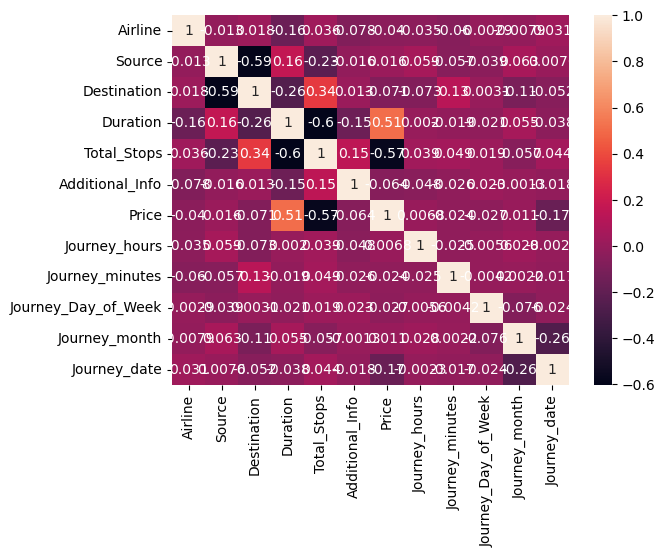

In [111]:
sns.heatmap(data1.corr(),annot=True)
#No two columns appear heavily correlated, so we will not remove any columns

### Model Building:
- Since this is a regression problem, we'll use all the three models of Linear Regression, KNN and ANN

#### 1. Linear Regression Model:
- This model is a 10d model with 10 independent variables, contributing to the change in dependent variable, 'Price'
- The model is y = m1x1+m2x2+m3x3+.......+c
- We split the entire data into 70% training data and 30% testing data

In [112]:
#Definining features and target variable
x = data1.drop(['Price'],axis=1)
y = data1.Price

In [57]:
x.head()

,Airline,Source,Destination,Duration,Total_Stops,Additional_Info,Journey_hours,Journey_minutes,Journey_Day_of_Week,Journey_month,Journey_date
0,0.272727,0.00,1.0,0.057793,1.00,0.875,0.956522,0.363636,0.500000,0.181818,0.875000
1,0.090909,0.75,0.0,0.154116,0.25,0.875,0.217391,0.909091,0.333333,0.000000,0.083333
2,0.363636,0.50,0.2,0.397548,0.25,0.875,0.391304,0.454545,0.000000,0.727273,0.125000
3,0.272727,0.75,0.0,0.112084,0.00,0.875,0.782609,0.090909,0.666667,1.000000,0.083333
4,0.272727,0.00,1.0,0.098074,0.00,0.875,0.695652,0.909091,0.666667,0.000000,0.000000


In [117]:
#Import data splitting functions and Linear Regression Models
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
x_train,x_test, y_train, y_test = train_test_split(x,y,test_size = 0.25,random_state=42)

In [59]:
print(len(x_train),len(y_train),len(x_test),len(y_test))

8012 8012 2671 2671


In [60]:
LR = LinearRegression() #creating instance of model
LR.fit(x_train,y_train) #Trianing the model

LinearRegression()

In [61]:
print(LR.coef_)

[ 0.00475228 -0.01322184  0.02032216  0.09072687 -0.06128299  0.02959449
  0.00834889 -0.00261741 -0.00510713 -0.01173842 -0.02253249]


In [62]:
y_pred = LR.predict(x_test)
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)


         Actual  Predicted     Error
6076   0.116844   0.097727  0.019118
3544   0.041156   0.117244 -0.076088
7313   0.167479   0.113899  0.053580
5032   0.026996   0.046230 -0.019235
2483   0.143261   0.092471  0.050790
9894   0.112793   0.120625 -0.007832
346    0.184173   0.102180  0.081993
6366   0.070351   0.053353  0.016998
8270   0.023639   0.051229 -0.027590
3393   0.186874   0.107495  0.079378
5412   0.028089   0.044214 -0.016125
8779   0.180122   0.132603  0.047518
9259   0.167916   0.165206  0.002711
6247   0.062146   0.113483 -0.051337
967    0.043304   0.064638 -0.021334
10502  0.012797   0.046043 -0.033246
6795   0.029208   0.034836 -0.005628
2391   0.056744   0.116000 -0.059257
4185   0.180700   0.127457  0.053244
9197   0.030726   0.033857 -0.003132
960    0.005350   0.048800 -0.043450
2507   0.039407   0.061225 -0.021818
3422   0.075225   0.058256  0.016969
6499   0.161267   0.122125  0.039142
7304   0.159376   0.124983  0.034393
2848   0.046905   0.039792  0.007113
3

In [63]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)

MSE: 0.0019341290326104555 MAE: 0.031870101256537886 RMSE: 0.04397873386775085


In [64]:
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

0.4275900252835988 0.42522202614035687


## 2. KNN
 - We use same x train y train and x test y test for this
 

In [65]:
#Definining features and target variable
x = data1.drop(['Price'],axis=1)
y = data1.Price
x_train,x_test, y_train, y_test = train_test_split(x,y,test_size = 0.25,random_state=42)

In [66]:
len(x_train)

8012

In [67]:
from sklearn.neighbors import KNeighborsRegressor
KNN = KNeighborsRegressor(n_neighbors = 4)
KNN.fit(x_train,y_train)

KNeighborsRegressor(n_neighbors=4)

In [68]:
y_pred = KNN.predict(x_test)
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)


         Actual  Predicted         Error
6076   0.116844   0.122243 -5.398506e-03
3544   0.041156   0.058348 -1.719226e-02
7313   0.167479   0.159267  8.211902e-03
5032   0.026996   0.030282 -3.286047e-03
2483   0.143261   0.131365  1.189665e-02
9894   0.112793   0.098790  1.400268e-02
346    0.184173   0.192218 -8.044706e-03
6366   0.070351   0.054435  1.591578e-02
8270   0.023639   0.050426 -2.678675e-02
3393   0.186874   0.185523  1.350430e-03
5412   0.028089   0.032742 -4.652554e-03
8779   0.180122   0.152216  2.790568e-02
9259   0.167916   0.183646 -1.572930e-02
6247   0.062146   0.062316 -1.704114e-04
967    0.043304   0.084087 -4.078299e-02
10502  0.012797   0.009408  3.388937e-03
6795   0.029208   0.040391 -1.118285e-02
2391   0.056744   0.093408 -3.666418e-02
4185   0.180700   0.151280  2.942009e-02
9197   0.030726   0.038060 -7.334122e-03
960    0.005350   0.011038 -5.687883e-03
2507   0.039407   0.059940 -2.053297e-02
3422   0.075225   0.044725  3.050043e-02
6499   0.161267 

In [69]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

MSE: 0.0009617367615260423 MAE: 0.01934589321945552 RMSE: 0.03101188097368559
0.7153717740300158 0.7141942973524416


In [70]:
#The r2 score can be checked for other values of k and optimal value of k can be arrived upon.
err = []
for i in range(1,15):
    KNN = KNeighborsRegressor(n_neighbors = i)
    KNN.fit(x_train,y_train)
    y_pred = KNN.predict(x_test)
    r2 = r2_score(y_test,y_pred)
    err.append(r2)
err

[0.6664816148691065,
 0.6732223741500343,
 0.7151437909139097,
 0.7153717740300158,
 0.7105275600576502,
 0.7087853499541046,
 0.7051814261301328,
 0.7031664484308999,
 0.6960122643538882,
 0.6897200327563449,
 0.6844098663174593,
 0.6871402974361687,
 0.6863812113554855,
 0.6838727645968036]

Text(0.5, 1.0, 'K vs r2')

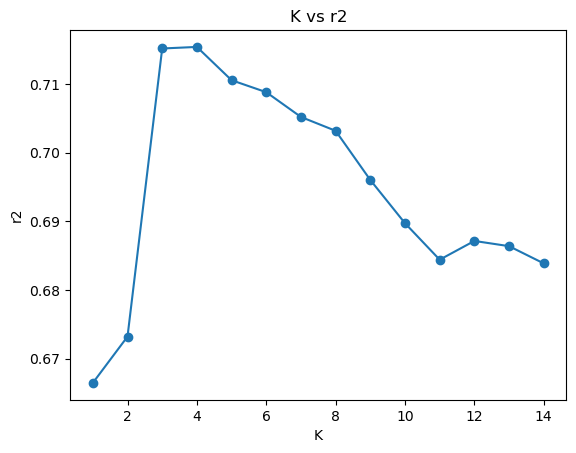

In [71]:
plt.plot(range(1,15),err,marker='o')
plt.xlabel('K')
plt.ylabel('r2')
plt.title('K vs r2')

In [72]:
# Despite testing for different k, k=4 itself is optimal wrt r2score

## 3. Using ANN - MLP regression

In [73]:
#Definining features and target variable
x = data1.drop(['Price'],axis=1)
y = data1.Price
x_train,x_test, y_train, y_test = train_test_split(x,y,test_size = 0.25,random_state=42)

In [74]:
from sklearn.neural_network import MLPRegressor
ANNmodel=MLPRegressor(hidden_layer_sizes = (100,),learning_rate_init=0.001, max_iter=300)  
ANNmodel.fit(x_train,y_train)

MLPRegressor(max_iter=300)

In [75]:
y_pred = ANNmodel.predict(x_test)
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)

         Actual  Predicted         Error
6076   0.116844   0.090395  2.644965e-02
3544   0.041156   0.084440 -4.328383e-02
7313   0.167479   0.120237  4.724236e-02
5032   0.026996   0.030243 -3.247260e-03
2483   0.143261   0.097182  4.607967e-02
9894   0.112793   0.107837  4.956186e-03
346    0.184173   0.116041  6.813157e-02
6366   0.070351   0.040330  3.002086e-02
8270   0.023639   0.042049 -1.840989e-02
3393   0.186874   0.099648  8.722552e-02
5412   0.028089   0.052231 -2.414207e-02
8779   0.180122   0.130409  4.971239e-02
9259   0.167916   0.176419 -8.502328e-03
6247   0.062146   0.087469 -2.532381e-02
967    0.043304   0.069347 -2.604302e-02
10502  0.012797   0.046969 -3.417238e-02
6795   0.029208   0.037642 -8.434085e-03
2391   0.056744   0.105024 -4.828021e-02
4185   0.180700   0.106689  7.401160e-02
9197   0.030726   0.038033 -7.307096e-03
960    0.005350   0.028050 -2.270001e-02
2507   0.039407   0.047790 -8.383107e-03
3422   0.075225   0.061102  1.412325e-02
6499   0.161267 

In [76]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

MSE: 0.0012873429206666505 MAE: 0.026438192355814523 RMSE: 0.0358795613221044
0.6190078757695021 0.6174317519009291


### 4. SVM Model

In [77]:
#Definining features and target variable
x = data1.drop(['Price'],axis=1)
y = data1.Price
x_train,x_test, y_train, y_test = train_test_split(x,y,test_size = 0.25,random_state=42)

In [78]:
from sklearn.svm import SVR
svr = SVR()
svr.fit(x_train,y_train)

SVR()

In [79]:
y_pred = svr.predict(x_test)
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)

         Actual  Predicted     Error
6076   0.116844   0.112477  0.004367
3544   0.041156   0.132242 -0.091086
7313   0.167479   0.114341  0.053138
5032   0.026996   0.100243 -0.073247
2483   0.143261   0.087031  0.056231
9894   0.112793   0.130507 -0.017714
346    0.184173   0.121344  0.062829
6366   0.070351   0.094643 -0.024292
8270   0.023639   0.107379 -0.083740
3393   0.186874   0.094724  0.092150
5412   0.028089   0.065826 -0.037737
8779   0.180122   0.151842  0.028279
9259   0.167916   0.158069  0.009848
6247   0.062146   0.127364 -0.065219
967    0.043304   0.104086 -0.060783
10502  0.012797   0.101944 -0.089148
6795   0.029208   0.094141 -0.064933
2391   0.056744   0.075225 -0.018482
4185   0.180700   0.127763  0.052937
9197   0.030726   0.122141 -0.091416
960    0.005350   0.082243 -0.076893
2507   0.039407   0.114779 -0.075372
3422   0.075225   0.107175 -0.031949
6499   0.161267   0.128699  0.032568
7304   0.159376   0.131985  0.027391
2848   0.046905   0.087643 -0.040738
3

In [80]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

MSE: 0.002651183221741045 MAE: 0.042762983453885975 RMSE: 0.051489641887869496
0.21537617432012113 0.21213026906157328


In [81]:
from sklearn.model_selection import GridSearchCV
#Define a parameter grid
#param_grid = {'C':[1,10,200,1000],'gamma':[1,0.1,0.31,0.001],'degree' : [3,8],'coef0' : [0.01,10,0.5],}
param_grid = {'kernel' : ('linear', 'poly', 'rbf', 'sigmoid'),'C' : [1,5,10,200],'gamma' : [1,0.1,0.01]}
grid = GridSearchCV(svr,param_grid,scoring='r2')

In [82]:
grid.fit(x_train,y_train)

GridSearchCV(estimator=SVR(),
             param_grid={'C': [1, 5, 10, 200], 'gamma': [1, 0.1, 0.01],
                         'kernel': ('linear', 'poly', 'rbf', 'sigmoid')},
             scoring='r2')

In [83]:
grid.best_params_

{'C': 200, 'gamma': 0.1, 'kernel': 'poly'}

In [90]:
svr = SVR(C = 200 ,gamma= 0.1, kernel= 'poly')

In [91]:
svr.fit(x_train,y_train)

SVR(C=200, gamma=0.1, kernel='poly')

In [92]:
y_pred = svr.predict(x_test)
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)

         Actual  Predicted     Error
6076   0.116844   0.098373  0.018471
3544   0.041156   0.129850 -0.088694
7313   0.167479   0.121917  0.045562
5032   0.026996   0.050270 -0.023274
2483   0.143261   0.080519  0.062742
9894   0.112793   0.127207 -0.014414
346    0.184173   0.136308  0.047865
6366   0.070351   0.101062 -0.030711
8270   0.023639   0.072014 -0.048375
3393   0.186874   0.092805  0.094068
5412   0.028089   0.033555 -0.005466
8779   0.180122   0.141273  0.038848
9259   0.167916   0.169266 -0.001350
6247   0.062146   0.124949 -0.062804
967    0.043304   0.135510 -0.092206
10502  0.012797   0.070392 -0.057596
6795   0.029208   0.025201  0.004007
2391   0.056744   0.105964 -0.049220
4185   0.180700   0.131484  0.049217
9197   0.030726   0.095173 -0.064447
960    0.005350   0.000500  0.004850
2507   0.039407   0.108247 -0.068840
3422   0.075225   0.095023 -0.019798
6499   0.161267   0.144984  0.016283
7304   0.159376   0.105841  0.053536
2848   0.046905   0.076147 -0.029242
3

In [93]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

MSE: 0.002251141011648475 MAE: 0.03770284326326571 RMSE: 0.04744619069691976
0.3337695945644368 0.33101347028471084


### Decision Tree

In [94]:
#Definining features and target variable
x = data1.drop(['Price'],axis=1)
y = data1.Price
x_train,x_test, y_train, y_test = train_test_split(x,y,test_size = 0.25,random_state=42)

In [96]:
from sklearn.tree import DecisionTreeRegressor
dt = DecisionTreeRegressor()
dt.fit(x_train,y_train)

DecisionTreeRegressor()

In [98]:
y_pred = dt.predict(x_test)
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)

         Actual  Predicted         Error
6076   0.116844   0.116844  1.387779e-17
3544   0.041156   0.067097 -2.594112e-02
7313   0.167479   0.167479 -2.775558e-17
5032   0.026996   0.023639  3.356784e-03
2483   0.143261   0.143261  0.000000e+00
9894   0.112793   0.100260  1.253328e-02
346    0.184173   0.184173  0.000000e+00
6366   0.070351   0.070351  1.387779e-17
8270   0.023639   0.023639  0.000000e+00
3393   0.186874   0.186874  0.000000e+00
5412   0.028089   0.028089  0.000000e+00
8779   0.180122   0.180122  0.000000e+00
9259   0.167916   0.199375 -3.145859e-02
6247   0.062146   0.063599 -1.453320e-03
967    0.043304   0.068820 -2.551670e-02
10502  0.012797   0.033864 -2.106671e-02
6795   0.029208   0.056397 -2.718866e-02
2391   0.056744   0.056744  0.000000e+00
4185   0.180700   0.191723 -1.102208e-02
9197   0.030726   0.032770 -2.044937e-03
960    0.005350   0.008720 -3.369645e-03
2507   0.039407   0.028089  1.131789e-02
3422   0.075225   0.049567  2.565817e-02
6499   0.161267 

In [99]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

MSE: 0.000845477785731562 MAE: 0.010895899586756467 RMSE: 0.02907710071055163
0.7497788876574117 0.7487437495469309


### Hyper parameter tuning for Decision Tree

In [100]:
from sklearn.model_selection import GridSearchCV
params = {"max_depth":list(range(1,20)),"min_samples_split":[3,6,9],"min_samples_leaf":list(range(2,20))}
tree_cv = GridSearchCV(dt,params,cv=3,scoring='r2')

In [101]:
tree_cv.fit(x_train,y_train)

GridSearchCV(cv=3, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                       13, 14, 15, 16, 17, 18, 19],
                         'min_samples_leaf': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
                                              12, 13, 14, 15, 16, 17, 18, 19],
                         'min_samples_split': [3, 6, 9]},
             scoring='r2')

In [102]:
tree_cv.best_params_

{'max_depth': 17, 'min_samples_leaf': 5, 'min_samples_split': 3}

In [103]:
dt = DecisionTreeRegressor(max_depth = 17, min_samples_leaf = 5, min_samples_split = 3)
dt.fit(x_train,y_train)

DecisionTreeRegressor(max_depth=17, min_samples_leaf=5, min_samples_split=3)

In [104]:
y_pred = dt.predict(x_test)
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)

         Actual  Predicted         Error
6076   0.116844   0.115288  1.556210e-03
3544   0.041156   0.063374 -2.221779e-02
7313   0.167479   0.152835  1.464359e-02
5032   0.026996   0.024310  2.685427e-03
2483   0.143261   0.143261  0.000000e+00
9894   0.112793   0.117131 -4.337453e-03
346    0.184173   0.185235 -1.061971e-03
6366   0.070351   0.070351  1.387779e-17
8270   0.023639   0.023379  2.604401e-04
3393   0.186874   0.185235  1.638889e-03
5412   0.028089   0.026650  1.439290e-03
8779   0.180122   0.191645 -1.152367e-02
9259   0.167916   0.182471 -1.455464e-02
6247   0.062146   0.066714 -4.568956e-03
967    0.043304   0.057095 -1.379154e-02
10502  0.012797   0.016308 -3.511119e-03
6795   0.029208   0.049537 -2.032933e-02
2391   0.056744   0.065751 -9.007155e-03
4185   0.180700   0.167586  1.311479e-02
9197   0.030726   0.039724 -8.998581e-03
960    0.005350   0.005618 -2.675138e-04
2507   0.039407   0.034918  4.488573e-03
3422   0.075225   0.046360  2.886545e-02
6499   0.161267 

In [105]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

MSE: 0.0006932350360038228 MAE: 0.011523605817193609 RMSE: 0.026329356923476554
0.7948354826689619 0.7939867388966259


## Random Forest Regression Model: (Bagging Model)

In [109]:
from sklearn.ensemble import RandomForestRegressor
rf_reg = RandomForestRegressor(n_estimators=100)
rf_reg.fit(x_train,y_train)
y_pred = rf_reg.predict(x_test)

In [110]:
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)

         Actual  Predicted         Error
6076   0.116844   0.115562  1.281880e-03
3544   0.041156   0.059764 -1.860816e-02
7313   0.167479   0.165562  1.917225e-03
5032   0.026996   0.025439  1.556467e-03
2483   0.143261   0.142181  1.080344e-03
9894   0.112793   0.108219  4.574355e-03
346    0.184173   0.182879  1.294355e-03
6366   0.070351   0.070756 -4.048718e-04
8270   0.023639   0.023913 -2.742016e-04
3393   0.186874   0.185530  1.343485e-03
5412   0.028089   0.030739 -2.650316e-03
8779   0.180122   0.185183 -5.061284e-03
9259   0.167916   0.192789 -2.487287e-02
6247   0.062146   0.058753  3.392281e-03
967    0.043304   0.064852 -2.154822e-02
10502  0.012797   0.018462 -5.664990e-03
6795   0.029208   0.045797 -1.658907e-02
2391   0.056744   0.063381 -6.637686e-03
4185   0.180700   0.167730  1.297005e-02
9197   0.030726   0.042017 -1.129165e-02
960    0.005350   0.004801  5.491750e-04
2507   0.039407   0.032334  7.072910e-03
3422   0.075225   0.047177  2.804844e-02
6499   0.161267 

In [111]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

MSE: 0.0005331407343686752 MAE: 0.009629878027813892 RMSE: 0.02308984050115278
0.842215762684474 0.8415630260878321


In [116]:
from sklearn.model_selection import GridSearchCV
params = {'n_estimators':[100,150,200,250], 'max_depth':[1,3,5,7,9,11,13],"min_samples_split":[3,6,9], 'min_samples_leaf':[2,4,6,8,10,12,14,16,18,20]}

grid_rf = GridSearchCV(RandomForestRegressor(),params,cv=3,scoring='r2')

In [118]:
grid_rf.fit(x_train,y_train)

GridSearchCV(cv=3, estimator=RandomForestRegressor(),
             param_grid={'max_depth': [1, 3, 5, 7, 9, 11, 13],
                         'min_samples_leaf': [2, 4, 6, 8, 10, 12, 14, 16, 18,
                                              20],
                         'min_samples_split': [3, 6, 9],
                         'n_estimators': [100, 150, 200, 250]},
             scoring='r2')

In [119]:
grid_rf.best_params_

{'max_depth': 13,
 'min_samples_leaf': 2,
 'min_samples_split': 3,
 'n_estimators': 200}

In [120]:
rfr = RandomForestRegressor(n_estimators=200,max_depth=13,min_samples_leaf=2,min_samples_split=3)
rfr.fit(x_train,y_train)
y_pred = rfr.predict(x_test)

In [121]:
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)

         Actual  Predicted         Error
6076   0.116844   0.110756  6.088659e-03
3544   0.041156   0.058381 -1.722536e-02
7313   0.167479   0.161514  5.965068e-03
5032   0.026996   0.026715  2.809179e-04
2483   0.143261   0.143144  1.173845e-04
9894   0.112793   0.106657  6.136154e-03
346    0.184173   0.182494  1.678776e-03
6366   0.070351   0.071201 -8.495547e-04
8270   0.023639   0.023807 -1.682784e-04
3393   0.186874   0.184911  1.962534e-03
5412   0.028089   0.030877 -2.788480e-03
8779   0.180122   0.189824 -9.702454e-03
9259   0.167916   0.190759 -2.284241e-02
6247   0.062146   0.058271  3.874899e-03
967    0.043304   0.060442 -1.713793e-02
10502  0.012797   0.016762 -3.965107e-03
6795   0.029208   0.046600 -1.739247e-02
2391   0.056744   0.063726 -6.981759e-03
4185   0.180700   0.162186  1.851436e-02
9197   0.030726   0.040449 -9.723698e-03
960    0.005350   0.004471  8.788857e-04
2507   0.039407   0.032723  6.684013e-03
3422   0.075225   0.047839  2.738624e-02
6499   0.161267 

In [122]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)

MSE: 0.000525879865949808 MAE: 0.010436669035833087 RMSE: 0.02293207068604595
0.8443646335395137 0.8437207865928927


# Conclusions:
- We have handled a business case of flight price prediction, where we are given a data that has the Airline name, Date of Journey, Source and Destination, Departure and Arrival Time, Route, Additional info (like layovers, business class etc), journey duration which are to be taken as features, while our target variable is the price of flight. 
- We first did our univariate analysis in which we understood that different airlines operate in different price segements, with some source points and destination points being more popular or pricey than others
- Similarly, the price segments varied based on source, destination, class of travel, journey duration too
- Few data points look like outliers when plotted, but in reality, they mostly may not be outliers, since they belonged to business class
- After analysing the data, we did data processing, which included, converting object datatypes to date/timestamp from which the data becomes more interpretable. We also encoded the categorical variables, to make sense while making a model.
- We then did data scaling, so that all the predictor variables are in same range of 0-1, which makes the coeffecient of gradient descent sensible, or high errors due to high variable values might affect the gradient which might result in non convergence of model
- Finally we applied different models of **Linear Regression, KNN, ANN - MLP, SVM - Regressor, Decision Tree Regressor, Random Forest-Regressor**
- The results are as follows

In [128]:
df = pd.DataFrame()
df['Algorithm'] = ['Linear Regression','KNN','ANN','SVM','SVM - Hyperparameter tuning','Decision Tree','Decision Tree with Hyperparameter tuning','Random Forest','Random Forest with hyperparameter tuning']
df['r2 score'] = [0.4276,0.7153,0.619,0.2153,0.3338,0.75,0.795,0.8422,0.845]
print('Various algorithms and their r2 scores: \n', df)

Various algorithms and their r2 scores: 
                                   Algorithm  r2 score
0                         Linear Regression    0.4276
1                                       KNN    0.7153
2                                       ANN    0.6190
3                                       SVM    0.2153
4               SVM - Hyperparameter tuning    0.3338
5                             Decision Tree    0.7500
6  Decision Tree with Hyperparameter tuning    0.7950
7                             Random Forest    0.8422
8  Random Forest with hyperparameter tuning    0.8450


- With that said, we hence conclude that, **Random Forest with tuned values of hyperparameters**, offers best model for our data.

In [113]:
x

,Airline,Source,Destination,Duration,Total_Stops,Additional_Info,Journey_hours,Journey_minutes,Journey_Day_of_Week,Journey_month,Journey_date
0,0.272727,0.00,1.0,0.057793,1.00,0.875,0.956522,0.363636,0.500000,0.181818,0.875000
1,0.090909,0.75,0.0,0.154116,0.25,0.875,0.217391,0.909091,0.333333,0.000000,0.083333
2,0.363636,0.50,0.2,0.397548,0.25,0.875,0.391304,0.454545,0.000000,0.727273,0.125000
3,0.272727,0.75,0.0,0.112084,0.00,0.875,0.782609,0.090909,0.666667,1.000000,0.083333
4,0.272727,0.00,1.0,0.098074,0.00,0.875,0.695652,0.909091,0.666667,0.000000,0.000000
5,0.727273,0.75,0.0,0.049037,1.00,0.875,0.391304,0.000000,0.166667,0.454545,0.875000
6,0.363636,0.00,1.0,0.323993,0.00,0.625,0.782609,1.000000,0.833333,1.000000,0.000000
7,0.363636,0.00,1.0,0.441331,0.00,0.875,0.347826,0.000000,0.666667,0.000000,0.000000
8,0.363636,0.00,1.0,0.534151,0.00,0.625,0.347826,1.000000,0.833333,1.000000,0.000000
9,0.545455,0.50,0.2,0.162872,0.00,0.875,0.478261,0.454545,0.166667,0.363636,1.000000


### Bagging a KNN model 

In [119]:
#Trying bagging on the model
from sklearn.ensemble import BaggingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
x_train,x_test, y_train, y_test = train_test_split(x,y,test_size = 0.25,random_state=42)
KNN = KNeighborsRegressor(n_neighbors = 4)
model_bag = BaggingRegressor(base_estimator=KNN,n_estimators=20) 
model_bag.fit(x_train,y_train)
y_pred=model_bag.predict(x_test)
#Comparing prediction and test values of target
df = pd.DataFrame()
df[0] = y_test
df[1] = y_pred
df[2] = df[0]-df[1]
df.rename({0:'Actual',1:'Predicted',2:'Error'},axis = 1,inplace = True)
print(df)
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)



         Actual  Predicted         Error
6076   0.116844   0.119875 -3.030430e-03
3544   0.041156   0.059403 -1.824688e-02
7313   0.167479   0.141080  2.639898e-02
5032   0.026996   0.028756 -1.760382e-03
2483   0.143261   0.125169  1.809255e-02
9894   0.112793   0.099710  1.308310e-02
346    0.184173   0.187962 -3.788600e-03
6366   0.070351   0.053034  1.731702e-02
8270   0.023639   0.066517 -4.287761e-02
3393   0.186874   0.173967  1.290658e-02
5412   0.028089   0.035321 -7.231875e-03
8779   0.180122   0.154808  2.531381e-02
9259   0.167916   0.183640 -1.572399e-02
6247   0.062146   0.071232 -9.086788e-03
967    0.043304   0.086860 -4.355636e-02
10502  0.012797   0.009885  2.912267e-03
6795   0.029208   0.040943 -1.173492e-02
2391   0.056744   0.081886 -2.514212e-02
4185   0.180700   0.146793  3.390753e-02
9197   0.030726   0.035476 -4.750299e-03
960    0.005350   0.027601 -2.225043e-02
2507   0.039407   0.052951 -1.354465e-02
3422   0.075225   0.044435  3.079061e-02
6499   0.161267 

#### Bagging a KNN shows that the R2 score to be 73.29% while, without bagging, KNN yielded 71.53% R2 score.

### Trying Gradient boosting and XG boosting on this model

In [121]:
from sklearn.ensemble import GradientBoostingRegressor
gbr = GradientBoostingRegressor()
gbr.fit(x_train,y_train)
y_pred = gbr.predict(x_test)

In [122]:
#Model Evaluation:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
print("MSE:" , mean_squared_error(y_test,y_pred),"MAE:", mean_absolute_error(y_test,y_pred),"RMSE:", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2, adj_r2)


MSE: 0.0005900484283943354 MAE: 0.01619979467961876 RMSE: 0.024290912465247894
0.8253737986018441 0.8246513885922993


In [124]:
pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 9.4 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [127]:
from xgboost import XGBRegressor
xgbr = XGBRegressor()
xgbr.fit(x_train,y_train)
y_pred = xgbr.predict(x_test)

In [130]:
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
print("MSE: ",mean_squared_error(y_test,y_pred),"MAE: ",mean_absolute_error(y_test,y_pred),"RMSE: ", mean_squared_error(y_test,y_pred)**0.5)
r2 = r2_score(y_test,y_pred)
adj_r2 = 1-((1-r2)*(2671-1)/(2671-11-1))
print(r2,adj_r2)

MSE:  0.0004418553318960446 MAE:  0.010699713979708873 RMSE:  0.021020355180064027
0.8692318893442401 0.8686909155882365


In [132]:
df = pd.DataFrame()
df['Algorithm'] = ['Linear Regression','KNN','ANN','SVM','SVM - Hyperparameter tuning','Decision Tree','Decision Tree with Hyperparameter tuning','Random Forest','Random Forest with hyperparameter tuning','Bagging with KNN','Gradient Boosting','XG boosting']
df['r2 score'] = [0.4276,0.7153,0.619,0.2153,0.3338,0.75,0.795,0.8422,0.845,0.733,0.825,0.87]
print('Various algorithms and their r2 scores: \n', df)

Various algorithms and their r2 scores: 
                                    Algorithm  r2 score
0                          Linear Regression    0.4276
1                                        KNN    0.7153
2                                        ANN    0.6190
3                                        SVM    0.2153
4                SVM - Hyperparameter tuning    0.3338
5                              Decision Tree    0.7500
6   Decision Tree with Hyperparameter tuning    0.7950
7                              Random Forest    0.8422
8   Random Forest with hyperparameter tuning    0.8450
9                           Bagging with KNN    0.7330
10                         Gradient Boosting    0.8250
11                               XG boosting    0.8700


# Summary:
XG boost proves to be efficient in increasing model performance with r2 score of 0.87